# UAV Object detection on mobile FPGA

In [1]:
import sys
import math
import numpy as np
import os
import time
from PIL import Image
from matplotlib import pyplot
import cv2
from datetime import datetime
import pynq
from pynq import Xlnk
from pynq import Overlay
from preprocessing import Agent
from preprocessing import BATCH_SIZE
from preprocessing import get_image_path
from IPython.display import display
import ctypes
from multiprocessing import Process
from multiprocessing import Array
from multiprocessing import Event
import numpy as np

from pynq.mmio import MMIO
import scipy.misc
import threading


team = 'MOHA'
agent = Agent(team)

In [2]:
OVERLAY_PATH = '../overlay/MOHA/MOHA.bit'
overlay = Overlay(OVERLAY_PATH)
dma = overlay.axi_dma_0


/usr/local/lib/python3.6/dist-packages/pynq/overlay.py:299: UserWarning: Users will not get PARAMETERS / REGISTERS information through TCL files. HWH file is recommended.
  warnings.warn(message, UserWarning)
/usr/local/lib/python3.6/dist-packages/pynq/lib/dma.py:200: UserWarning: Failed to find parameter c_sg_length_width; users should really use *.hwh files for overlays.
  warnings.warn(message, UserWarning)


Data flows from PS to PL, then back to PS by DMA.



### Timing and Energy measuring

In this cell, we will:
  * Download weights
  * Run the code for image resizing and processing.
  * Measure the time and energy for processing all the images. 
  
The timer should start before "PS reading the first image" and end after "PS receiving all results".  The code below shows how to measure the total energy usage.

Got nn_ctrl!


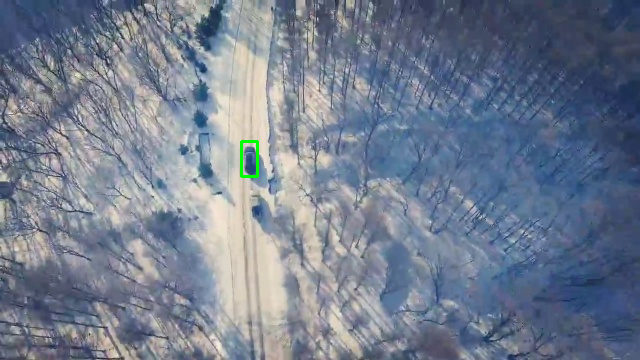

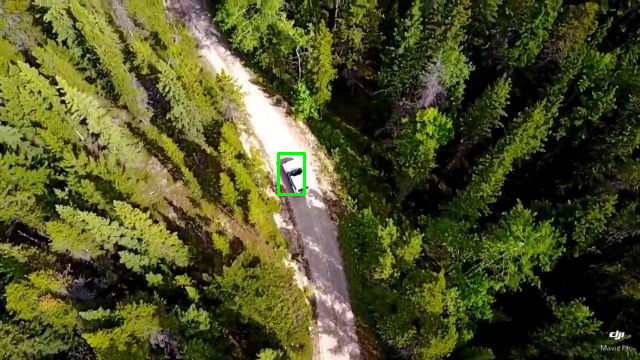

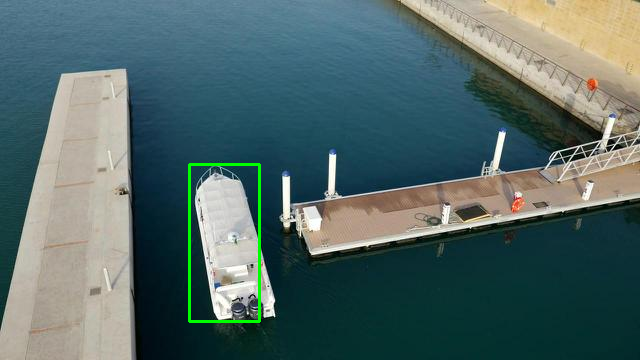

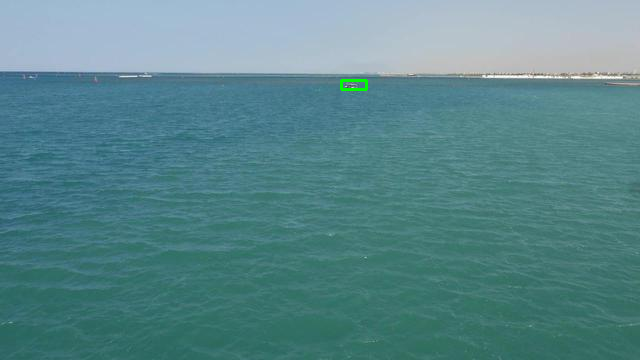

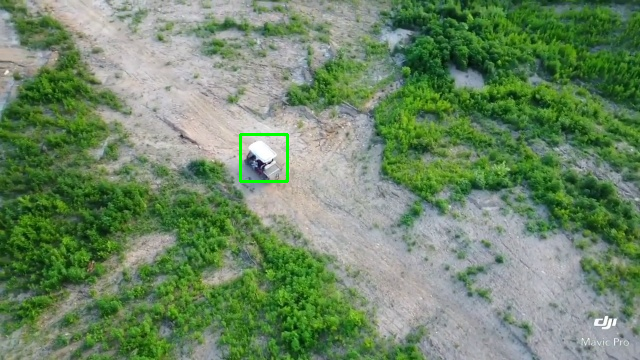

...

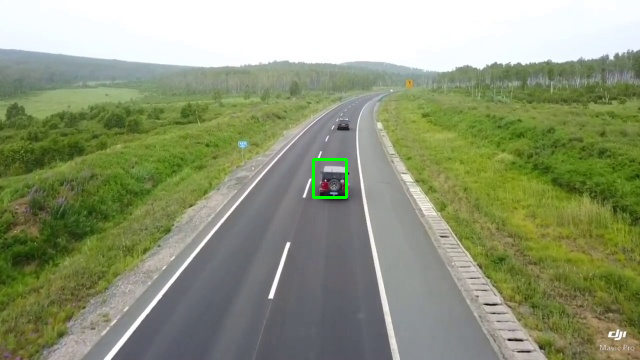

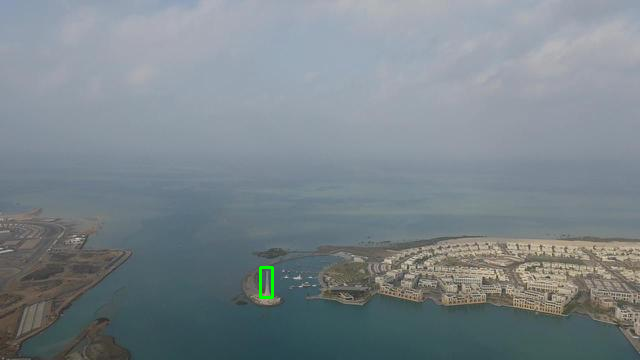

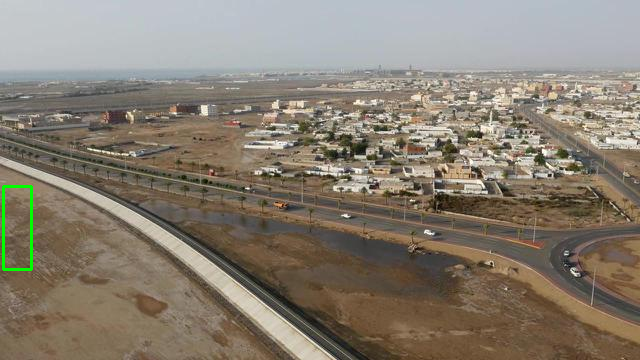

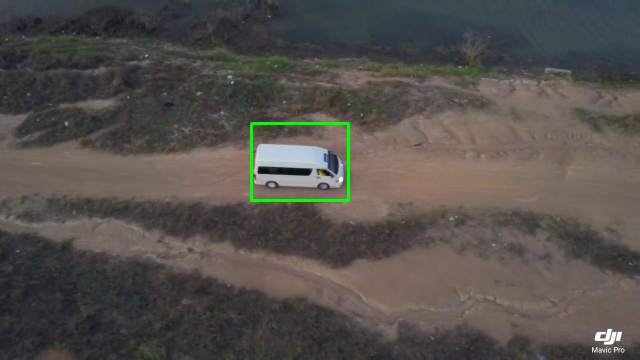

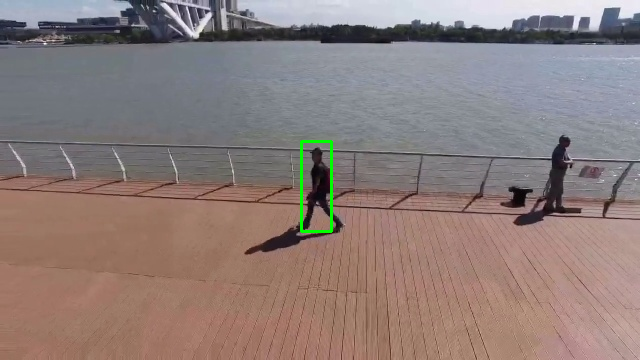

In [ ]:
interval_time = 0
total_time = 0
total_num_img = len(agent.img_list)
result = list()
agent.reset_batch_count()
rails = pynq.get_rails()

WEIGHTS_FILE_NAME = '../overlay/MOHA/MOHA_weights.txt'

xlnk = Xlnk()
nn_ctrl = MMIO(0xa0010000, length=1024)
print('Got nn_ctrl!')


## Allocate SW weight buffers and load from text file
weights_file = open(WEIGHTS_FILE_NAME, "r")
layer = 0
pw_weight_iterations = np.zeros(7)
conv_weight_iterations = np.zeros(7)
pw_factor_iterations = np.zeros(7)
conv_factor_iterations = np.zeros(7)
for line in weights_file:
    if "layer" in line:
        temp = line.split(": ")
        layer = int(temp[1])
    if "pw_weight_iterations" in line:
        temp = line.split(": ")
        pw_weight_iterations[layer] = int(temp[1])
    if "conv_weight_iterations" in line:
        temp = line.split(": ")
        conv_weight_iterations[layer] = int(temp[1])
    if "pw_factor_iterations" in line:
        temp = line.split(": ")
        pw_factor_iterations[layer] = int(temp[1])
    if "conv_factor_iterations" in line:
        temp = line.split(": ")
        conv_factor_iterations[layer] = int(temp[1])
weights_file.close()
weightfactors_length = np.zeros(7)
for i in range(0, 7):
    weightfactors_length[i] = int(pw_weight_iterations[i] + \
                                conv_weight_iterations[i] + \
                                pw_factor_iterations[i] + \
                                conv_factor_iterations[i])
weightsfactors = []
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[0]),), dtype=np.uint32) )
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[1]),), dtype=np.uint32) )
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[2]),), dtype=np.uint32) )
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[3]),), dtype=np.uint32) )
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[4]),), dtype=np.uint32) )
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[5]),), dtype=np.uint32) )
weightsfactors.append( xlnk.cma_array(shape=(int(16*weightfactors_length[6]),), dtype=np.uint32) )
index = 0
weights_file = open(WEIGHTS_FILE_NAME, "r")
for line in weights_file:
    if "layer" in line:
        temp = line.split(": ")
        layer = int(temp[1])
        index = 0
    elif "pw_weight_iterations" not in line and \
            "conv_weight_iterations" not in line and \
            "pw_factor_iterations" not in line and \
            "conv_factor_iterations" not in line:
        no0x = line.split('0x')[-1]
        base = 1
        while base < len(no0x):
            part = no0x[-1*(base+8):-1*base]    
            weightsfactors[layer][index*16 + int(base/8)] = int(part, 16)
            base += 8
        index += 1


MINIBATCH_SIZE = 16
height = 224
width = 224
pixel_bits = 24
pixels_per_line = 384/pixel_bits
num_lines = int((height*width)/pixels_per_line)

shared_arr = Array(ctypes.c_uint8, MINIBATCH_SIZE*num_lines * 64)
in_buffer = xlnk.cma_array(shape=(MINIBATCH_SIZE*num_lines, 64), dtype=np.uint8)

fire1_num_out_lines = 28*28*MINIBATCH_SIZE
fire1_out_buffer = xlnk.cma_array(shape=(int(16*fire1_num_out_lines),), dtype=np.uint32)
fire2345_num_out_lines = 14*14*MINIBATCH_SIZE
fire2_out_buffer = xlnk.cma_array(shape=(int(16*fire2345_num_out_lines),), dtype=np.uint32)
fire3_out_buffer = xlnk.cma_array(shape=(int(16*fire2345_num_out_lines),), dtype=np.uint32)
bndboxes = xlnk.cma_array(shape=(int(MINIBATCH_SIZE),16), dtype=np.int32)
result_rectangles = []
total_energy = 0.0
read_img_time = 0.0
actual_running_time = 0.0
read_result_time = 0.0
resize_time = 0.0

## Define transfer functions
def weightsfactors_transfer(weightsfactors):
    nn_ctrl.write(0x68, 13)
    nn_ctrl.write(0x70, 0)
    nn_ctrl.write(0x0, 0) # Reset
    nn_ctrl.write(0x0, 1) # Deassert reset
    dma.sendchannel.transfer(weightsfactors)
    dma.sendchannel.wait()
    
def fire(inbuffer, outbuffer, 
         pw_din, pw_cin, pw_cout, 
         conv_din, conv_din_afterpool, conv_cin, conv_cout, 
         whichfire):
    nn_ctrl.write(0x0, 0) # Reset
    nn_ctrl.write(0x10, pw_din)
    nn_ctrl.write(0x18, pw__cin)
    nn_ctrl.write(0x20, pw_cout)
    nn_ctrl.write(0x28, 0)
    nn_ctrl.write(0x30, 0)
    nn_ctrl.write(0x38, conv_din)
    nn_ctrl.write(0x40, conv_din_afterpool)
    nn_ctrl.write(0x48, conv_cin)
    nn_ctrl.write(0x50, conv_cout)
    nn_ctrl.write(0x58, 0)
    nn_ctrl.write(0x60, 0)
    nn_ctrl.write(0x68, whichfire)
    nn_ctrl.write(0x70, MINIBATCH_SIZE) # set numReps
    nn_ctrl.write(0x0, 1) # Deassert reset
    dma.recvchannel.transfer(outbuffer)
    dma.sendchannel.transfer(inbuffer)
    
def image_reader(
    shared_arr, 
    batch: list, 
    minibatch_size: int, 
    new_height: int, 
    new_width: int, 
    num_lines: int, 
    in_buffer_finish_written,
    in_buffer_available
    ):
    in_buffer = np.frombuffer(shared_arr.get_obj(), dtype=np.uint8)
    in_buffer.shape = (minibatch_size*num_lines, 64)
    actual_batch_size = len(batch)
    mini_batch_num = math.ceil(actual_batch_size / minibatch_size)
    for mini_idx in range(mini_batch_num):
        actual_mini_batch_size = min(len(batch), (mini_idx + 1) * minibatch_size) - mini_idx * minibatch_size
        in_buffer_available.wait()
        #print("reader start reading")
        for idx in range(actual_mini_batch_size):
            #bgr_array = cv2.imread(batch[mini_idx * minibatch_size + idx])
            bgr_array = cv2.imread(get_image_path(batch[mini_idx * minibatch_size + idx]))
            image = cv2.resize(bgr_array, (new_height, new_width))
            in_buffer[idx*num_lines:(idx+1)*num_lines,0:48] = np.reshape(image, (num_lines, 48))
        #print("reader finish reading")
        in_buffer_available.clear()
        in_buffer_finish_written.set()
        

for i in range(math.ceil(total_num_img/BATCH_SIZE)):
    # get a batch from agent
    batch = agent.send(interval_time, agent.img_batch)
    actual_batch_size = len(batch)
    img_list = sorted(batch)

    # timer start when PS reading image
    start = time.time()
    temp_time0 = start

    recorder = pynq.DataRecorder(rails['power1'].power)
    
    in_buffer_finish_written = Event()
    in_buffer_available = Event()
    image_reader_process = Process(target=image_reader, args=(
        shared_arr, 
        batch, 
        MINIBATCH_SIZE, 
        height, 
        width, 
        num_lines, 
        in_buffer_finish_written,
        in_buffer_available))
    in_buffer_available.set()
    in_buffer_finish_written.clear()
        
    with recorder.record(0.01):      
        image_reader_process.start()
        
        for mini_idx in range(math.ceil(actual_batch_size / MINIBATCH_SIZE)):
            minibatch_actual_size = min(len(batch), (mini_idx + 1) * MINIBATCH_SIZE) - mini_idx * MINIBATCH_SIZE
            mini_batch_result = np.zeros((MINIBATCH_SIZE,5), dtype=np.float)
            in_buffer_finish_written.wait()
            #print("start processing")
            in_buffer_temp = np.frombuffer(shared_arr.get_obj(), dtype=np.uint8)
            in_buffer_temp.shape = (MINIBATCH_SIZE*num_lines, 64)
            in_buffer[:,:] = in_buffer_temp[:, :]
                        
             
            weightsfactors_transfer(weightsfactors[0])
            fire(in_buffer, fire1_out_buffer, 
             56, 32, 128, 56, 28, 128, 160, 1)
            dma.recvchannel.wait()
            
            in_buffer_finish_written.clear()
            in_buffer_available.set()    
            
            weightsfactors_transfer(weightsfactors[1])
            fire(fire1_out_buffer, fire2_out_buffer,
             28, 160, 128, 28, 14, 128, 160, 2)
            dma.recvchannel.wait()
            weightsfactors_transfer(weightsfactors[2])
            fire(fire2_out_buffer, fire3_out_buffer,
            14, 160, 128, 14, 14, 128, 160, 3)
            dma.recvchannel.wait()
            weightsfactors_transfer(weightsfactors[3])
            fire(fire3_out_buffer, fire2_out_buffer,
            14, 160, 128, 14, 14, 128, 160, 4)
            dma.recvchannel.wait()
            weightsfactors_transfer(weightsfactors[4])
            fire(fire2_out_buffer, fire3_out_buffer,
            14, 160, 128, 14, 14, 128, 160, 5)
            dma.recvchannel.wait()
            weightsfactors_transfer(weightsfactors[5])
            fire(fire3_out_buffer, fire2_out_buffer,
            14, 160, 128, 14, 14, 128, 160, 6)
            dma.recvchannel.wait()
            
            weightsfactors_transfer(weightsfactors[6])
            fire(fire2_out_buffer, bndboxes,
            14, 160, 128, 14, 14, 128, 160, 7)
            dma.recvchannel.wait()
            mini_batch_result[:,:] = bndboxes.astype("int32")[:,0:5]
            #print("fire7_out", fire3_out_buffer)
            
            temp_time1 = time.time()
            t = temp_time1 - temp_time0
            temp_time0 = temp_time1
            actual_running_time += t

            
            for i in range(minibatch_actual_size):
                float_objdetect = mini_batch_result[i,4]
                float_bndboxes = mini_batch_result[i,0:4]

                #print(float_bndboxes)
                #print(float_objdetect)
                float_bndboxes = np.divide( float_bndboxes, float((1<<22)) )
                #print("first dividen: " + str(float_bndboxes))
                float_bndboxes *= 0xa034aa

                float_bndboxes = np.divide( float_bndboxes, float((1<<22)) )
                #print("second dividen: " + str(float_bndboxes))

                obj_h = int(float_objdetect/14)
                obj_w = int(float_objdetect%14)
                x_min = int((float_bndboxes[0] + obj_w*16) *(640/width))
                y_min = int((float_bndboxes[1] + obj_h*16) *(360/height))
                x_max = int((float_bndboxes[2] + obj_w*16) *(640/width))
                y_max = int((float_bndboxes[3] + obj_h*16) *(360/height))

                result_rectangles.append([x_min, x_max, y_min, y_max])
                #bgr_array = cv2.imread(get_image_path(batch[mini_idx * MINIBATCH_SIZE + i]))
                #cv2.rectangle(bgr_array, (x_min, y_min), (x_max, y_max), (0,255,0), 2)
                #display(scipy.misc.toimage( cv2.cvtColor(bgr_array, cv2.COLOR_BGR2RGB) ))
            
            temp_time1 = time.time()
            t = temp_time1 - temp_time0
            temp_time0 = temp_time1
            read_result_time += t
            
    # timer stop after PS has received image
    end = time.time()
    t = end - start
    
    energy = recorder.frame["power1_power"].mean() * t
    
    #print('Processing time: {} seconds.'.format(t))
    #print('Energy: {} J.'.format(energy))
    total_time += t
    total_energy += energy

In [4]:
agent.save_results_xml(result_rectangles, total_time, total_energy)
print("XML results written successfully.")

XML results written successfully.


In [5]:
print(len(result_rectangles))
print(total_time)
print(total_energy)
print(read_img_time)
print(read_result_time)
print(actual_running_time)
print(resize_time)

23380
1191.0822367668152
7005.99675258
0.0
44.607460498809814
1146.2307884693146
0.0


### Cleaning up
Remember to free the contiguous memory after usage.

In [7]:
xlnk.xlnk_reset()